<a href="https://colab.research.google.com/github/vn322/RUDN_Lab_Works/blob/main/Alg_lab_8_1_Video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


# OpenCV

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

## Чтение видеофайла

Функция `cv2.VideoCapture()` используется для чтения видеофайла. С помощью метода `isOpened()` можно проверить, успешно ли файл прочитан (если успешно, метод вернёт `True`).

    cv2.VideoCapture(device_index or path_to_file)

      Функция принимает 1 параметр - вариант захвата видео, который может быть:
            device_index - захват наприямую с камеры (если камер несколько то индексация 0, 1, 2 и тд);
            path_to_file - путь к видеофайлу, например 'video.avi'.

In [ ]:
# путь к видеозаписи
path_video = '/content/drive/MyDrive/Temp/times-square.mp4'

# чтение файла
vidcap = cv2.VideoCapture(path_video)

# проверка
vidcap.isOpened()

True

Проверка методом `isOpened()` крайне желательна, ведь если мы укажем неверный путь к файлу, то сама по себе функция `cv2.VideoCapture()` никаких ошибок не выявит.



In [ ]:
# путь к несуществующему файлу
path_video = 'yjftyftyntybedytdrtdykf'

# чтение файла
wrcap = cv2.VideoCapture(path_video)

In [ ]:
# проверка
wrcap.isOpened()

False

Чтобы закрыть файл используется метод `release()`.

In [ ]:
# проверка файла открытого ранее
print(vidcap.isOpened())

# закрытие видеофайла
vidcap.release()

# проверка после закрытия
print(vidcap.isOpened())

True
False


## Чтение и установка параметров видео

Для получения параметров видео используется метод `get()`.

    get(propId)

        propId - идентификатор свойства. Несколько примеров:
            cv2.CAP_PROP_FRAME_WIDTH - ширина кадров;
            cv2.CAP_PROP_FRAME_HEIGHT - высота кадров;
            cv2.CAP_PROP_FPS - частота кадров;
            cv2.CAP_PROP_FRAME_COUNT - количество кадров в видеофайле;
            cv2.CAP_PROP_POS_FRAMES - индекс фрейма, который будет захвачен следующим (индексация начинается с 0).


Полный список идентификаторов свойств можно найти по ссылке [ALL_PROPERTIES](https://docs.opencv.org/3.4/d4/d15/group__videoio__flags__base.html#gaeb8dd9c89c10a5c63c139bf7c4f5704d).

In [ ]:
# путь к видеозаписи
path_video = '/content/drive/MyDrive/Temp/times-square.mp4'

# чтение файла
vidcap = cv2.VideoCapture(path_video)

# проверка
vidcap.isOpened()

True

In [ ]:
# выведем ширину кадров
print(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))

# выведем высоту кадров
print(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# выведем частоту кадров
print(vidcap.get(cv2.CAP_PROP_FPS))

1920.0
1012.0
29.97002997002997


Для установки параметров используется метод `set()`. Установить можно не все параметры из списка properties, а только некоторые.

    set(propid, value)

        propId - идентификатор свойства;
        value - новое значение.

In [ ]:
# проверим какой фрейм (кадр) будет захвачен следующим
print(vidcap.get(cv2.CAP_PROP_POS_FRAMES))

# изменить следующий захватываемый кадр на 100
print(vidcap.set(cv2.CAP_PROP_POS_FRAMES, 100))

# проверим результат изменения
print(vidcap.get(cv2.CAP_PROP_POS_FRAMES))

0.0
True
100.0


Если при выполнении метода `set()` мы получили `True`, значит изменение параметра выполнено успешно. Например, ширину или высоту кадров изменить нельзя.

In [ ]:
# попробуем изменить ширину кадров
print(vidcap.set(cv2.CAP_PROP_FRAME_WIDTH, 1000))

False


## Получение кадров в виде массивов numpy

Если мы проверим индекс следующего фрема, который будет захвачен (при этом ещё ни один кадр мы не захватывали), то значение будет 0.

In [ ]:
# путь к видеозаписи
path_video = '/content/drive/MyDrive/Temp/times-square.mp4'

# чтение файла
vidcap = cv2.VideoCapture(path_video)

# проверка
print(vidcap.isOpened())

# проверим какой фрейм (кадр) будет захвачен следующим
print(vidcap.get(cv2.CAP_PROP_POS_FRAMES))

True
0.0


Чтобы получить кадр в виде массива numpy (это и есть захват) используется метод `read()`, который вернёт bool (указывает, что фрейм был успешно прочитан) и массив изображения numpy.

In [ ]:
# считаем фрейм
hasFrame, image = vidcap.read()

# посмотрим что получили
print(hasFrame)
print(type(image))
print(image.shape)
print(image)

True
<class 'numpy.ndarray'>
(1012, 1920, 3)
[[[172 170 171]
  [173 171 172]
  [178 176 177]
  ...
  [ 41  45  58]
  [ 40  44  57]
  [ 40  44  57]]

 [[175 173 174]
  [175 173 174]
  [178 176 177]
  ...
  [ 37  41  54]
  [ 36  40  53]
  [ 36  40  53]]

 [[192 190 191]
  [191 189 190]
  [191 189 190]
  ...
  [ 32  41  62]
  [ 32  41  62]
  [ 32  41  62]]

 ...

 [[139 132 134]
  [139 132 134]
  [139 132 134]
  ...
  [ 35  48  67]
  [ 35  48  67]
  [ 35  48  67]]

 [[143 136 138]
  [143 136 138]
  [143 136 138]
  ...
  [ 36  45  65]
  [ 34  43  63]
  [ 34  43  63]]

 [[145 138 140]
  [145 138 140]
  [145 138 140]
  ...
  [ 34  43  63]
  [ 32  41  61]
  [ 32  41  61]]]


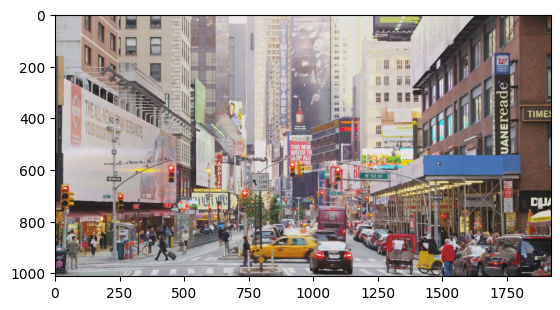

In [ ]:
# переведем BGR в RGB
color = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# визуализируем полученный кадр
plt.imshow(color)
plt.show()

In [ ]:
# проверим какой фрейм (кадр) будет захвачен следующим
print(vidcap.get(cv2.CAP_PROP_POS_FRAMES))

1.0


Индекс следующего фрейма изменился с 0 на 1, а это значит, что при вызове метода `read()` мы проходим по всем кадрам по порядку.

Теперь, при помощи цикла `for` выведем 10 следующих кадров.

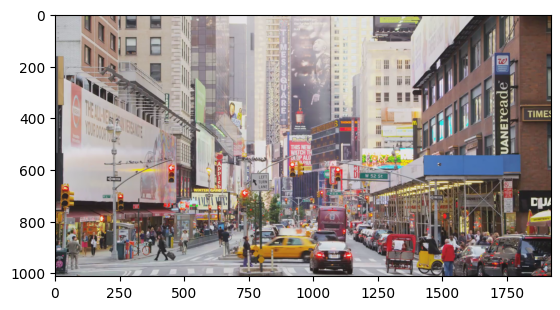

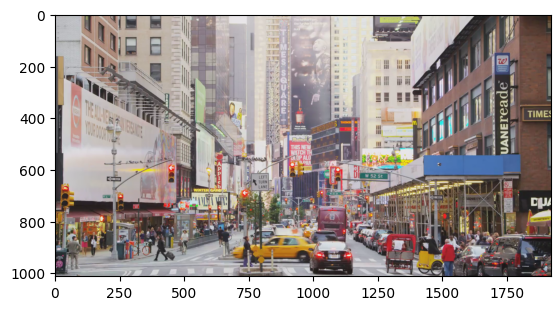

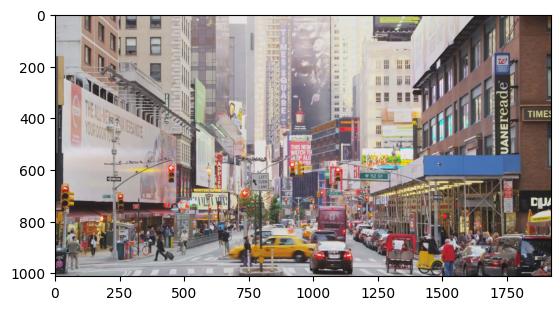

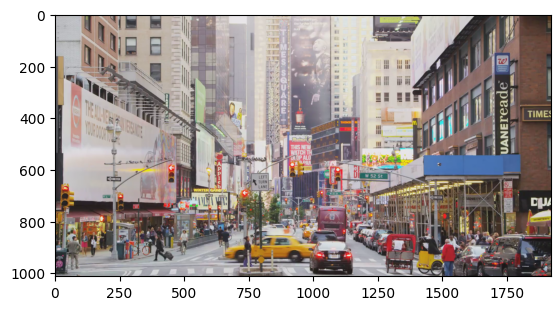

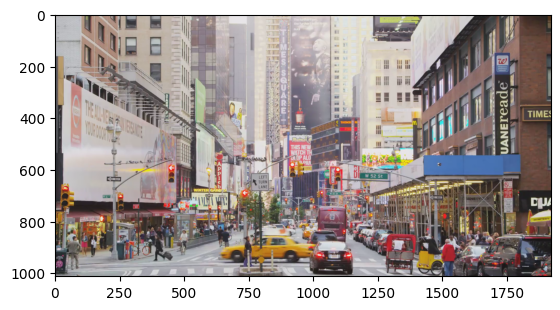

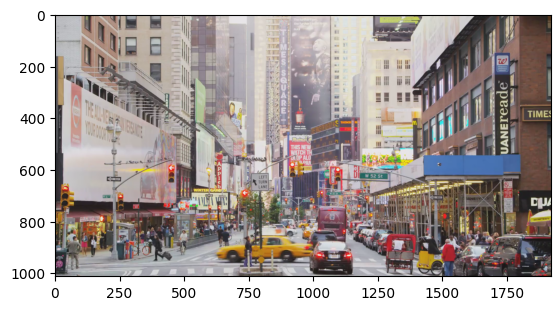

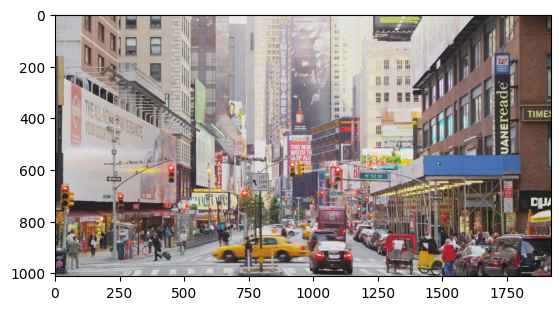

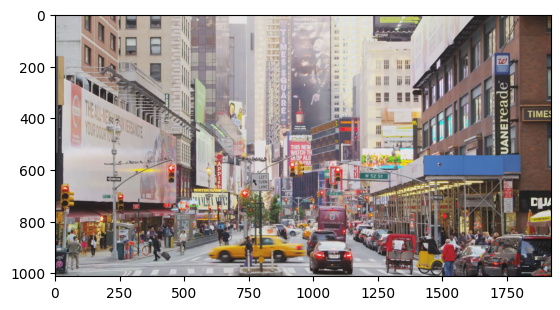

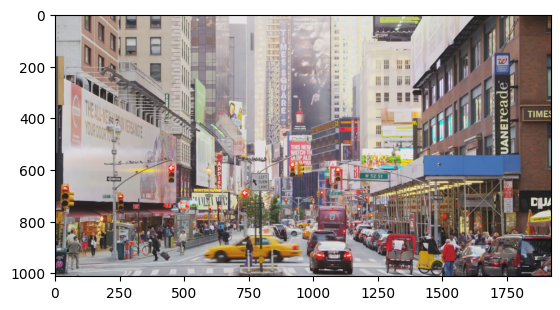

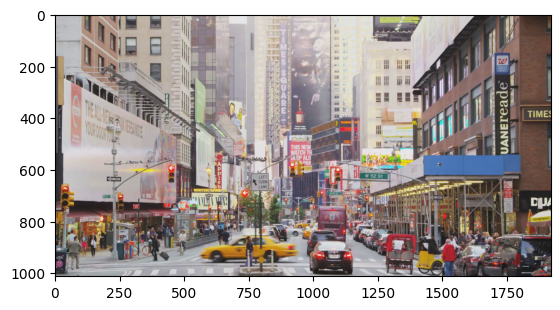

In [ ]:
for i in range(10):

  # считаем фрейм
  hasFrame, image = vidcap.read()

  # переведем BGR в RGB
  color = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  # визуализируем полученный кадр
  plt.imshow(color)
  plt.show()

11.0


Таким образом, мы можем пройтись по любому количеству кадров и выполнить любые операции с каждым кадром, которые мы выполняли с изображениями (например выполнить детекцию объектов при помощи yolo).

In [ ]:
# если нужно пройтись по всем кадрам
while hasFrame:

  # считаем фрейм
  hasFrame, image = vidcap.read()

# закрытие видеофайла
# vidcap.release()

In [ ]:
# проверим какой фрейм (кадр) будет захвачен следующим
print(vidcap.get(cv2.CAP_PROP_POS_FRAMES))

645.0


In [ ]:
# проверим, что сейчас записано в переменных
print(hasFrame)
print(image)

False
None


## Запись кадров в видеофайл

Если нам необходимо выполнить над каждым фреймом какую-либо операцию и затем, сохранить изменения снова в формате видео, то нам поможет функция `cv2.VideoWriter()`.

    cv2.VideoWriter(filename, fourcc, fps, frameSize)

        filename - путь к видеофайлу, который будет сохранен;
        fourcc - 4-значный код кодека, используемый для сжатия кадров;
        fps - количество кадров в секунду;
        frameSize - размер кадров;
        isColor - bool, цветное или ч/б изображение.

4-значный код кодека передается посредством функции `cv2.VideoWriter_fourcc(ch1, ch2, ch3, ch4)`, например `cv2.VideoWriter_fourcc('MJPG')` - это кодек motion-jpeg, а `cv2.VideoWriter_fourcc('MP42')` - кодек MPEG4. Полный список кодеков можно посмотреть по ссылке [Список кодеков](https://web.archive.org/web/20220316062600/http://www.fourcc.org/codecs.php)

Выполним горизонтальный флип видео.

In [ ]:
 # путь к видеозаписи
path_video = '/content/drive/MyDrive/Temp/times-square.mp4'

# чтение файла
vidcap = cv2.VideoCapture(path_video)

# проверка
print(vidcap.isOpened())

# ширина и высота кадров
frame_width = int(vidcap.get(3))
frame_height = int(vidcap.get(4))
size = (frame_width, frame_height)

# инициализация функции записи
result = cv2.VideoWriter('filename.mp4',
                         cv2.VideoWriter_fourcc('M','P','4','V'),
                         10,
                         size,
                         True)

# флаг для первой итерации
hasFrame = True

# проходим по всем кадрам
while hasFrame:

  # считаем фрейм
  hasFrame, image = vidcap.read()

  # проверка последнего фрейма
  if hasFrame:

    # выполним отзеркаливание
    imageFLIP = cv2.flip(image, 1)

    # записываем текущий кадр
    result.write(imageFLIP)

# закрываем захват видео и запись
vidcap.release()
result.release()

True


In [ ]:
# cv2.VideoWriter_fourcc('M','J','P','G') - 196 мб
# cv2.VideoWriter_fourcc('M','P','4','V') - 28 мб

# MoviePy

## Воспроизведение видеофайла

In [ ]:
from moviepy.editor import VideoFileClip

video = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4")
video.ipython_display(width=500, center=False)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Определение параметров видео

In [ ]:
# загружаем видео
video = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4")

# определяем длительность
print('Длительность:', video.duration)

# ширина и высота кадров
width = video.w
height = video.h
print('Ширина:', width)
print('Высота:', height)

# частота кадров
print('FPS:', video.fps)

# путь к файлу
print('Путь к файлу:', video.filename)

## Обрезка видеофайла

Для получения части видео используется метод `.subclip(i, j)`, где i - начало воспроизведения, а j - конец (в секундах).

In [ ]:
# загружаем видео
video = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4")

# берем отрезок с 15 по 20 секунду
video = video.subclip(15,20)

# воспроизведем полученный отрезок
video.ipython_display(width=500, center=False)

## Ресайз кадров

Для изменения высоты и ширины кадров используется метод `.resize()`

In [ ]:
# загружаем видео
video = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4")

# ширина и высота кадров
width = video.w
height = video.h
print(width, height)

In [ ]:
# ресайз кадров в процентном соотношении (уменьшение на 50%)
video_2 = video.resize(0.5)

# измененные размеры
width_2 = video_2.w
height_2 = video_2.h
print(width_2, height_2)

In [ ]:
# ресайз кадров в пикселях
video_3 = video.resize((300, 200))

# измененные размеры
width_3 = video_3.w
height_3 = video_3.h
print(width_3, height_3)

In [ ]:
# ресайз кадров с указанием одного параметра (ширины или высоты)
# второй параметр будет изменён автоматически сохраняя пропорции
video_4 = video.resize(width=800)

# измененные размеры
width_4 = video_4.w
height_4 = video_4.h
print(width_4, height_4)

## Получение кадра в виде массива

Для получения кадра из видео используется метод `.get_frame()`.

Метод имеет единственный параметр - время откуда будет взят кадр (float).

In [ ]:
# загружаем видео
video = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4")

# получение фрейма из времени 2.1 с
frame = video.get_frame(2.1)

# выведем фрейм на экран
plt.imshow(frame)
plt.show()

## Объединение двух видеофайлов

Для объединения двух видеофайлов используется метод `.concatenate_videoclips()`

    concatenate_videoclips(clips, method, transition, bg_color)

        clips - список клипов для объединения;
        method - метод объединения. Может быть:
            'chain' - создаст клип, который последовательно выводит кадры
                      клипов без каких-либо исправлений, если они не имеют
                      одинакового размера.
            'compose' - если клипы имеют разное разрешение, окончательный клип
                      будет иметь высоту самого высокого клипа и ширину самого
                      широкого клипа в списке. Все клипы меньшего размера будут
                      отображаться по центру. Граница будет прозрачной, если
                      mask=True, в противном случае она будет иметь цвет,
                      указанный в bg_color.
        transition - клип, который будет воспроизводиться между каждыми двумя клипами в списке;
        bg_color - цвет фона (только для метода 'compose').


In [ ]:
from moviepy.editor import concatenate_videoclips

# загружаем первое видео
video1 = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4")
video1 = video1.subclip(15, 20)
print('Video 1:')
print('Ширина:', video1.w)
print('Высота:', video1.h)
print()

# загружаем второе видео
video2 = VideoFileClip("/content/drive/MyDrive/Temp/drone-flying-over-mountain-top-lake-4k.mp4")
video2 = video2.subclip(0, 5)
print('Video 2:')
print('Ширина:', video2.w)
print('Высота:', video2.h)

In [ ]:
# объединяем 2 видеофайла (последовательно)
final = concatenate_videoclips([video2, video1], 'compose')

# воспроизведем полученный результат
final.ipython_display(width=500, center=False)

Второе видео имеет меньшее разрешение, поэтому сверху и снизу появились темные полосы (фон).

Чтобы использовать метод `'chain'`, желательно сначала привести оба видео к одному разрешению.

In [ ]:
# меняем разрешение 1-го файла
video1 = video1.resize((800, 600))

# меняем разрешение 2-го файла
video2 = video2.resize((800, 600))

# объединяем 2 видеофайла (последовательно)
final = concatenate_videoclips([video2, video1], 'chain')

# воспроизведем полученный результат
final.ipython_display(width=500, center=False)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Наложение аудиодорожки на видео

Для наложения аудио на видео, сначала нужно открыть аудиофайл при помощи функции `AudioFileClip()`, а затем использовать метод `.set_audio()` для наложения на видео.

In [ ]:
from moviepy.editor import AudioFileClip

# загружаем аудиофайл
audioclip = AudioFileClip("/content/drive/MyDrive/Temp/zvuki-goroda.mp3").subclip(0,10)

# воспроизведем аудио
audioclip.ipython_display(center=False)

MoviePy - Writing audio in __temp__.mp3


MoviePy - Done.


In [ ]:
# загружаем видеофайл
videoclip = VideoFileClip("/content/drive/MyDrive/Temp/times-square.mp4").subclip(0,10)

# накладываем аудио на видео
video = videoclip.set_audio(audioclip)

# воспроизведем полученный результат
video.ipython_display(width=500, center=False)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


Для коректного наложения длина аудио и видео клипов должна быть одинаковой.

## Запись в файл

Запишем предыдущее видео с наложенным на него звуком в отдельный файл. Для этого воспользуемся методом `.write_videofile()`

    write_videofile(filename, fps=None, codec=None, audio=True, preset='medium')

        filename - имя видеофайла для записи;
        fps - количество кадров в секунду;
        codec - кодек для кодирования изображения. Может быть любым кодеком, поддерживаемым ffmpeg;
        audio - включать ли в результирующий файл аудиосопровождение. Может быть True, False или имя аудиофайла;
        preset - время, которое FFMPEG потратит на оптимизацию сжатия. Может быть:
            'ultrafast', 'superfast', 'veryfast', 'faster', 'fast', 'medium',
            'slow', 'slower', 'veryslow', 'placebo'.
            Это не влияет на качество видео, а только на размер видеофайла.

In [ ]:
# сохраняем видео в файл 'noisy_city.mp4'
video.write_videofile("noisy_city.mp4")

Moviepy - Building video noisy_city.mp4.
MoviePy - Writing audio in noisy_cityTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video noisy_city.mp4



Moviepy - Done !
Moviepy - video ready noisy_city.mp4


Расширение итогового файла должно соответствовать используемому «кодеку» или просто быть `.avi` (который будет работать с любым кодеком).

In [ ]:
# сохраняем видео в файл 'noisy_city.avi'
video.write_videofile("noisy_city.avi", codec='rawvideo')

Moviepy - Building video noisy_city.avi.
MoviePy - Writing audio in noisy_cityTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video noisy_city.avi



Moviepy - Done !
Moviepy - video ready noisy_city.avi


In [ ]:
# файл noisy_city.mp4 - 3.75 Мб
# файл noisy_city.avi - 1.64 Гб

# VidGear

In [ ]:
pip install -U vidgear[core]

**VidGear** построен на автономных API-интерфейсах, также известных как Gears, каждый из которых обладает некоторыми уникальными функциями.

1. **CamGear**: многопоточный API, ориентированный на различные IP-USB-камеры/сетевые потоки/стриминговые сайты-URL.
2. **PiGear**: многопоточный API, ориентированный на различные модули камеры Raspberry-Pi.
3. **ScreenGear**: многопоточный API для сверхбыстрой трансляции экрана.
4. **VideoGear**: общий API захвата видео с внутренней оболочкой стабилизатора видео.
5. **WriteGear**: используется для кодирования, сжатия файлов/потоков/кадров и записи в файл.
6. **StreamGear**: обрабатывает транскодирование высококачественных, динамических и адаптивных форматов потоковой передачи.
7. **WebGear**: видеосервер ASGI, транслирующий Live MJPEG-кадры на любой веб-браузер в сети.
8. **WebGear_RTC**: медиа-сервер Asyncio WebRTC в режиме реального времени для потоковой передачи напрямую одноранговым клиентам по сети.
9. **NetGear**: обеспечивает высокопроизводительную передачу видеокадров и данных между взаимосвязанными системами по сети.
10. **NetGear_Async**: платформа для обмена сетевыми сообщениями Asyncio Video-Frames с эффективным использованием памяти.
11. **Stabilizer** — это вспомогательный класс, который обеспечивает стабилизацию видео для vidgear с минимальной задержкой и практически без дополнительных вычислительных требований.

В рамках colab мы можем воспользоваться лишь некоторыми gears.

### CamGear

По аналогии с OpenCV делаем захват видео. Для этого используется класс `CamGear()`. Некоторые параметры при вызове класса:

    CamGear(source, stream_mode, colorspace, backend, options, logging, time_delay)

        source - источник входного потока. Может быть:
                - значением int (например 0, 1, 2 и тд.) - индекс подключенной камеры;
                - ссылкой на видеофайл (например `/home/foo.mp4`);
                - URL адрес стрим сервиса (наример `https://www.youtube.com/watch?v=MVPTGNGiI-4`);
                - адрес сети (например `rtsp://192.168.31.163:554/`).
        stream_mode - управляет режимом потоковой передачи. Если True, API CamGear будет
                      интерпретировать входные данные как URL-адрес;
        colorspace - цветовое пространство входного потока (например `COLOR_BGR2HSV`);
        options -  различные параметры исходной настройки, доступные в OpenCV;
        time_delay - устанавливает временную задержку (в секундах) перед тем,
                     как CamGear API начнет считывать кадры.


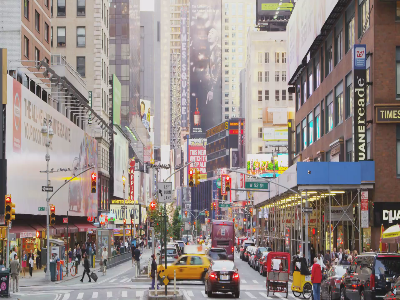

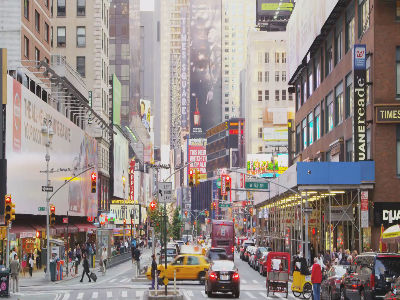

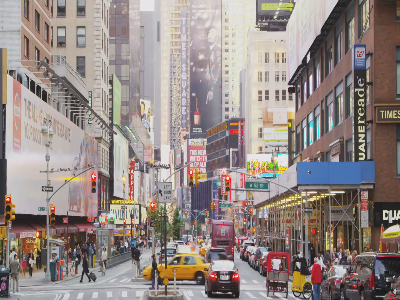

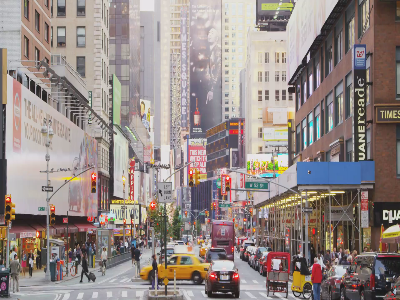

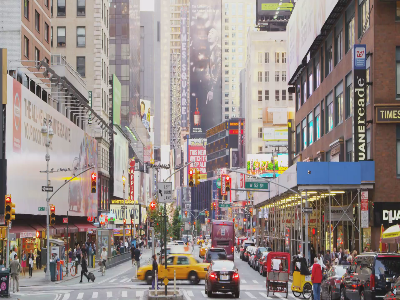

In [ ]:
from vidgear.gears import CamGear
from google.colab.patches import cv2_imshow
import cv2

# откроем видео с гугл-диска
stream = CamGear(source="/content/drive/MyDrive/Temp/times-square.mp4",).start()

# возьмем первые 5 кадров
for i in range(5):

    # считываем кадр из видео
    frame = stream.read()

    # проверяем не пустой ли это кадр
    if frame is None:
        break

    # поменяем разрешение кадра
    frame = cv2.resize(frame, (400,300))

    # выводим результат на экран
    cv2_imshow(frame)

# закрываем видеофайл
stream.stop()

Захват видео из YouTube

In [ ]:
pip install yt_dlp

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


10:05:56 ::    Helper     :: WARNING  :: GStreamer not found!
10:05:56 ::    CamGear    ::   INFO   :: Verifying Streaming URL using yt-dlp backend. Please wait...
10:05:58 ::    CamGear    ::   INFO   :: [Backend] :: Streaming URL is fully supported. Available Streams are: [360p, 720p, best, worst]


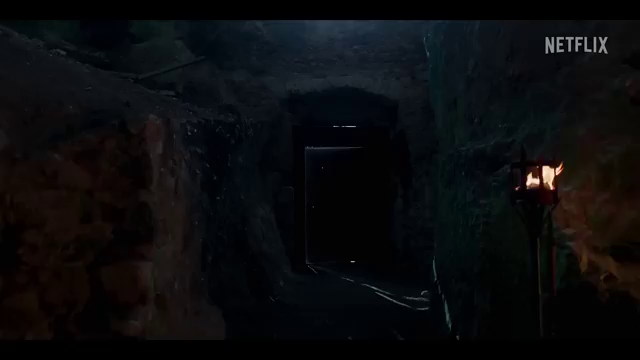

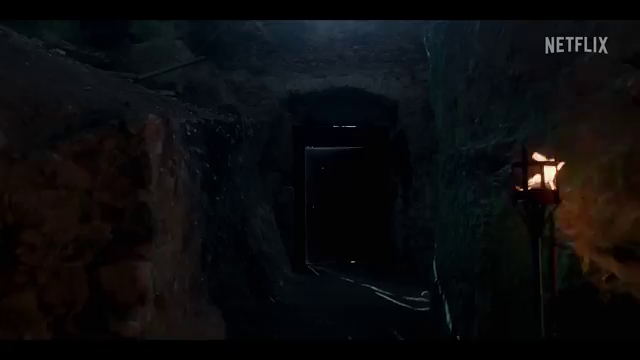

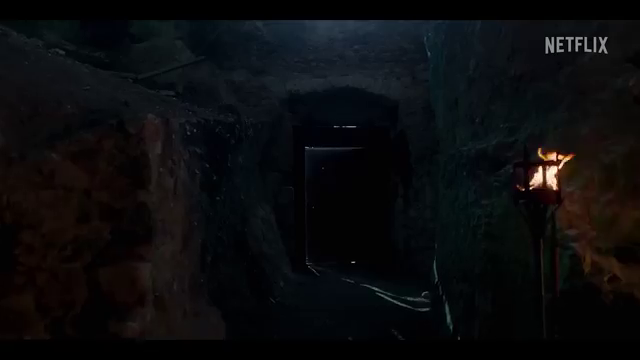

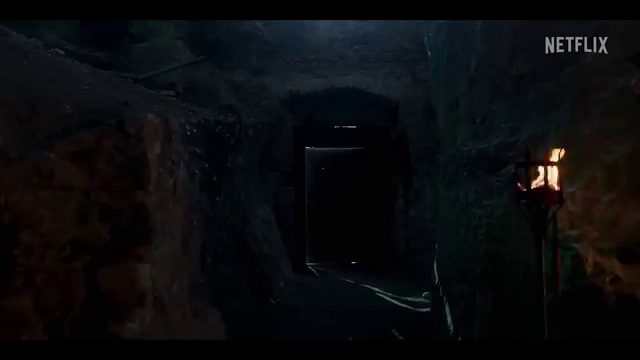

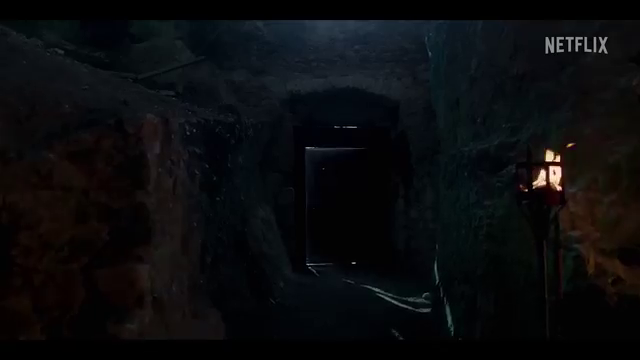

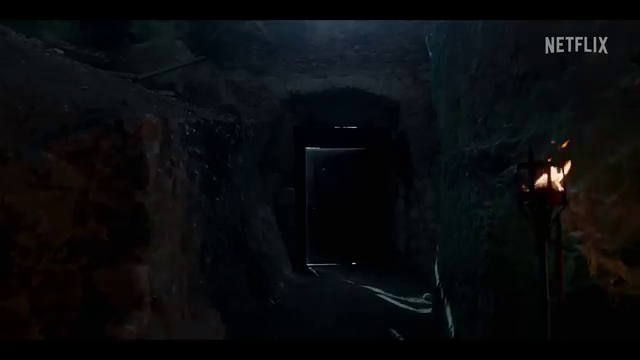

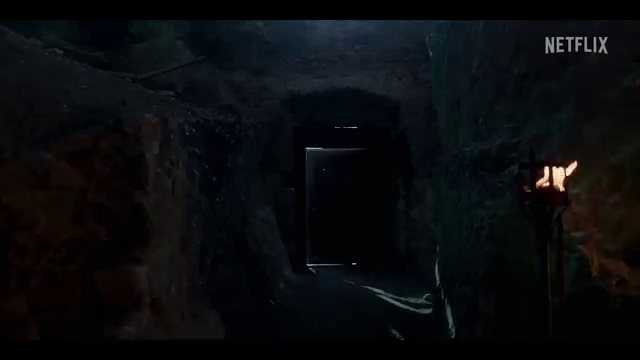

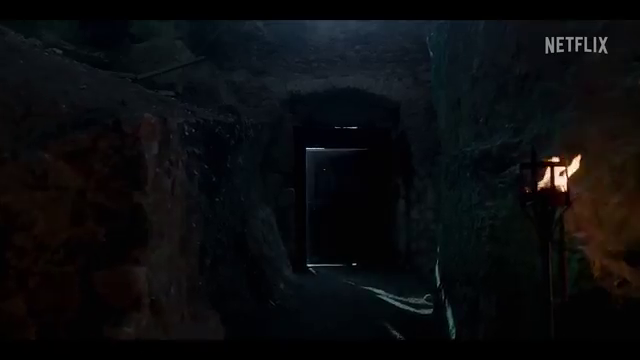

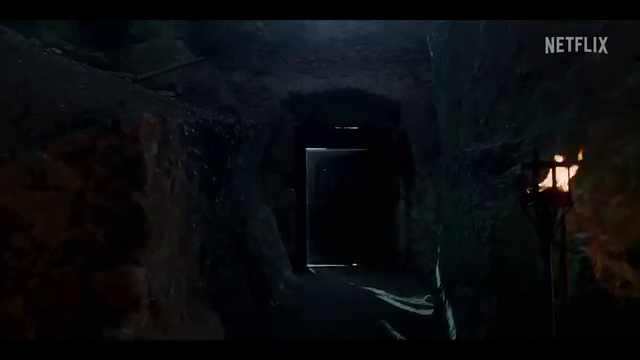

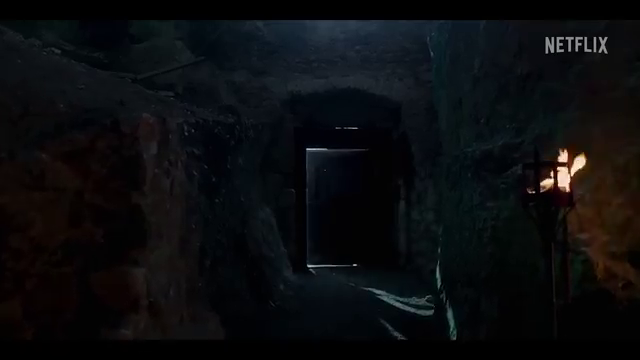

In [ ]:
# параметр качества
options = {"STREAM_RESOLUTION": "360p"}

# options = {"CAP_PROP_FRAME_WIDTH": 320,
#            "CAP_PROP_FRAME_HEIGHT": 240,
#            "CAP_PROP_FPS": 60}

# делаем захват видео по ссылке
stream = CamGear(
    source="https://www.youtube.com/watch?v=kbOtnAzYaps",
    stream_mode=True,
    **options).start()

# возьмем первые 10 кадров видео
for i in range(10):

    # считываем кадр из видео
    frame = stream.read()

    # проверяем не пустой ли это кадр
    if frame is None:
        break

    # выводим результат на экран
    cv2_imshow(frame)

# закрываем видеофайл
stream.stop()

### WriteGear

Запись видео в файл производится при помощи класса `WriteGear().` Некоторые параметры:

    WriteGear(output, compression_mode, custom_ffmpeg, output_params)

        output - путь/имя файла;
        compression_mode - bool, использовать режим сжатия или нет;
        custom_ffmpeg - расположение пользовательского пути/каталога для пользовательских исполняемых файлов FFmpeg;
        output_params - обеспечивает гибкость управления поддерживаемыми внутренними параметрами и свойствами FFmpeg.

In [ ]:
from vidgear.gears import WriteGear

# укажем ссылку на видео из youtube
stream = CamGear(source="https://www.youtube.com/watch?v=xRBk79hjwfE",
                 stream_mode=True
                 ).start()

# инициализируем класс WriteGear и указываем имя итогового файла
writer = WriteGear(output="Output.mp4")

# бесконечный цикл
while True:

    # считываем кадр
    frame = stream.read()

    # проверяем не пустой ли кадр
    if frame is None:
        break

    # добавляем кадр в итоговый файл
    writer.write(frame)

# закрываем видео
stream.stop()

# закрываем итоговый файл
writer.close()

10:06:08 ::    Helper     :: WARNING  :: GStreamer not found!
10:06:09 ::    CamGear    ::   INFO   :: Verifying Streaming URL using yt-dlp backend. Please wait...
10:06:12 ::    CamGear    ::   INFO   :: [Backend] :: Streaming URL is fully supported. Available Streams are: [360p, 720p, best, worst]


In [ ]:
from moviepy.editor import VideoFileClip

# воспроизведем полученное видео
video = VideoFileClip("/content/Output.mp4").subclip(3,15)
video.ipython_display(width=500, center=False)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
# сохраняем видео в файл 'not_stable.mp4'
video.write_videofile('not_stable.mp4')

Moviepy - Building video not_stable.mp4.
Moviepy - Writing video not_stable.mp4



Moviepy - Done !
Moviepy - video ready not_stable.mp4


### Stabilizer

Стабилизацию кадров можно сделать при помощи класса `Stabilizer()`. Некоторые параметры класса:

    Stabilizer(smoothing_radius, border_size, crop_n_zoom, border_type)

        smoothing_radius - размера окна усреднения. По умолчанию 25;
        border_size - устанавливает значение расширенного размера границы, которое компенсирует уменьшение черных рамок во время стабилизации.
                      По умолчанию 0;
        crop_n_zoom - bool, работает в связке с параметром border_size, т.е. когда этот параметр включен,
                      border_size будет использоваться для обрезки границ, а не для их расширения;
        border_type - изменение типа границ. Может быть 'black', 'reflect', 'reflect_101', 'replicate' или 'wrap'.

In [ ]:
from vidgear.gears.stabilizer import Stabilizer

# путь к файлу
unstabilized_videofile = "/content/not_stable.mp4"

# захват при помощи cv2
stream = cv2.VideoCapture(unstabilized_videofile)

# инициализируем стабилизатор
stab = Stabilizer(smoothing_radius=30,
                  crop_n_zoom=True,
                  border_size=5)

# инициализируем класс для записи в файл Stable.mp4
writer = WriteGear(output="Stable.mp4")

# бесконечный цикл
while True:

    # считываем кадр
    (grabbed, frame) = stream.read()

    # проверяем захвачен ли кадр
    if not grabbed:
        break

    # отправляем кадр в стабилизптор
    stabilized_frame = stab.stabilize(frame)

    # ждем инициализации стабилизатора
    if stabilized_frame is None:
        continue

    # записываем стабилизированный фрейм в файл
    writer.write(stabilized_frame)


# закрываем открытые ресурсы
stab.clean()
stream.release()
writer.close()

In [ ]:
# воспроизведем полученное видео
video = VideoFileClip("/content/Stable.mp4")
video.ipython_display(width=500, center=False)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


# **Задание**

## **Часть 1**

Задача 1

При помощи библиотеки cv2, откройте видеофайл из занятия ‘times-square.mp4’ и выведите на экран каждый сотый кадр.

Задача 2

При помощи библиотеки cv2, откройте видеофайл из занятия ‘times-square.mp4’ и выведите на экран только 5, 168 и 409 кадры.

Задача 3

При помощи библиотеки cv2, откройте видеофайл из занятия ‘times-square.mp4’. Пройдитесь по всем кадрам записи и сделайте горизонтальный флип. Сохраните отзеркаленное видео в новый файл ‘flip.mp4’.

Задача 4

При помощи библиотеки MoviePy, откройте видеофайл из занятия ‘times-square.mp4’ и выведите на экран видео для воспроизведения с 5 по 15 секунду.

Задача 5

При помощи библиотеки VidGear, сделайте захват любого видео из YouTube и сохраните его в файл ‘download.mp4’.



## **Часть 2**
Задача 1
При помощи библиотеки cv2, откройте видеофайл из занятия ‘times-square.mp4’. Выполните операцию оконтуривания для всех кадров видео и сохраните результат в файл ‘contour.mp4’.

Задача 2
При помощи библиотеки cv2,  откройте видеофайл из занятия ‘times-square.mp4’. Сделайте так, чтобы видео начиналось черно-белым и постепенно, к концу стало цветным. Выведите результат на экран при помощи библиотеки MoviePy.

Задача 3
Найдите на YouTube видео с плохой стабилизацией и исправьте её при помощи класса Stabilizer библиотеки VidGear. Выведите результат на экран при помощи библиотеки MoviePy.

Задача 4
При помощи библиотеки MoviePy, объедините первые 10 секунд видеофайлов из занятия ‘times-square.mp4’ и ‘drone-flying-over-mountain-top-lake-4k.mp4’ таким образом, чтобы кадры из одного и другого видео чередовались по очереди. Выведите результат на экран.

Задача 5
При помощи библиотеки cv2, сделайте видео, в котором зеленый круг на черном фоне перемещается в разные углы экрана. Видео должно иметь разрешение 800х600, с частотой 10 fps. Выведите итоговое видео на экран при помощи библиотеки MoviePy.
